In [1]:
import tensorflow as tf

In [2]:
from __future__ import print_function
from scipy.misc import imsave
from scipy.optimize import fmin_l_bfgs_b
import numpy as np
import time
from keras.applications import vgg19
from keras import backend as K

from keras.preprocessing import image
from keras.models import Model
from keras.applications.vgg19 import preprocess_input

import matplotlib.pyplot as plt

%matplotlib inline

Using TensorFlow backend.


In [3]:
#Preprocessing des données
content = image.load_img("chien.jpg")
content_array = image.img_to_array(content)

height = content_array.shape[0]
width = content_array.shape[1]

style = image.load_img("style.jpg", target_size=(height,width))
style_array = image.img_to_array(style)

content_array = np.expand_dims(content_array, axis=0)
content_array = preprocess_input(content_array)

style_array = np.expand_dims(style_array, axis=0)
style_array = preprocess_input(style_array)

assert content_array.shape == style_array.shape

generated = K.placeholder(shape=(1,height, width, 3))
content = K.variable(content_array)
style = K.variable(style_array)

print("Height :",height)
print("Width :", width)

Height : 467
Width : 700


In [4]:
#Création du modèle
model = vgg19.VGG19(weights='imagenet', input_tensor=K.concatenate([content,style,generated], axis=0),include_top=False)

In [5]:
#Calcul matrice de Gram
def gram(tensor):
    arranged = K.permute_dimensions(tensor, (2,0,1))
    arranged = K.batch_flatten(arranged)
    return K.dot(arranged, K.transpose(arranged))

In [6]:
def style_loss(gram_style,gram_generated,shape):
    Ml = shape[1] * shape[2]
    Nl = shape[3]
    return K.sum(K.square(gram_generated - gram_style))/(4.*(Ml ** 2) * (Nl ** 2))

In [7]:
def content_loss(content,generated):
    return K.sum(K.square(generated - content))/2.

In [8]:
layers_name = [layer.name for layer in model.layers]
layers_style = ["block1_conv1", "block2_conv1", "block3_conv1", "block4_conv1", "block5_conv1"]
layers_content = ["block4_conv1"]

In [9]:
dict_shape = {}
for name in layers_name:
    dict_shape[name] = model.get_layer(name).output_shape
    
print(dict_shape)

{'block1_pool': (3, 233, 350, 64), 'block5_conv2': (3, 29, 43, 512), 'block4_conv2': (3, 58, 87, 512), 'block3_conv1': (3, 116, 175, 256), 'block3_conv4': (3, 116, 175, 256), 'block2_pool': (3, 116, 175, 128), 'block1_conv2': (3, 467, 700, 64), 'block4_pool': (3, 29, 43, 512), 'block4_conv3': (3, 58, 87, 512), 'block2_conv2': (3, 233, 350, 128), 'block5_conv3': (3, 29, 43, 512), 'block3_pool': (3, 58, 87, 256), 'block5_conv4': (3, 29, 43, 512), 'block2_conv1': (3, 233, 350, 128), 'block5_pool': (3, 14, 21, 512), 'block3_conv2': (3, 116, 175, 256), 'block4_conv4': (3, 58, 87, 512), 'input_1': (3, 467, 700, 3), 'block5_conv1': (3, 29, 43, 512), 'block1_conv1': (3, 467, 700, 64), 'block4_conv1': (3, 58, 87, 512), 'block3_conv3': (3, 116, 175, 256)}


In [10]:
model_dict = dict((name,model.get_layer(name).output) for name in layers_name)

In [11]:
#Construction de la loss de style
loss_variable = K.variable(0)
content_coeff = 0.001 #content
style_coeff = 1 #style

loss_style_variable = K.variable(0)
for name in layers_style:
    layer = model_dict[name]
    layer_generated = layer[2,:,:,:]
    layer_style = layer[1,:,:,:]
    
    gram_style = gram(layer_style)
    gram_generated = gram(layer_generated)
    
    shape = dict_shape[name]
    print(shape)
    loss_style_variable +=  (style_loss(gram_style, gram_generated,shape)/len(layers_style))

(3, 467, 700, 64)
(3, 233, 350, 128)
(3, 116, 175, 256)
(3, 58, 87, 512)
(3, 29, 43, 512)


In [12]:
#Construction de la loss de content
loss_content_variable = K.variable(0.)
for name in layers_content:
    layer = model_dict[name]
    layer_generated = layer[2,:,:,:]
    layer_content = layer[0,:,:,:]
    loss_content_variable += (content_loss(layer_content, layer_generated)) / len(layers_content)

In [13]:
#Construction de la loss globale
total_loss = content_coeff * loss_content_variable + style_coeff * loss_style_variable

In [14]:
gradients = K.gradients(total_loss, generated)[0]

In [15]:
evaluate_loss_grads = K.function([generated], [total_loss, gradients])

In [16]:
#Reconstruction de l'image d'origine
def build_img(img_data, height, width):
    img = img_data.reshape((height, width, 3))

    img[:, :, 0] += 103.939
    img[:, :, 1] += 116.779
    img[:, :, 2] += 123.68
    
    
    img = img[:, :, ::-1]
    img = np.clip(img, 0, 255).astype('uint8')
    return img

In [59]:
#Génération d'une image aléatoire 
img_data = np.random.uniform(110,150,((1, height, width,3)))
img_data = preprocess_input(img_data)

In [60]:
#Nesterov acceleration
iterate = K.function([generated], [gradients, total_loss])
num_epoch = 100
losses = []
import math

smooth_number = 550.
lambdas = [0]
for i in range(num_epoch + 1):
    last_lambda = lambdas[i]
    new_lambda = (1. + math.sqrt(1. + 4.*(last_lambda**2.) ))/2.
    lambdas.append(new_lambda)
print(lambdas)

gammas = [(1. - lambdas[i])/lambdas[i+1] for i in range(len(lambdas) - 1)]

ys = [0.]
print(gammas)

[0, 1.0, 1.618033988749895, 2.193527085331054, 2.749791340120445, 3.2948796779470473, 3.83260140013, 4.365078717475032, 4.8936217645302005, 5.419098898607719, 5.942116580237085, 6.463115750438564, 6.982427415989093, 7.500306608967648, 8.016954119091308, 8.53253094283583, 9.047168203004484, 9.56097414704707, 10.074039201951413, 10.586439701027011, 11.098240681522611, 11.609498018587676, 12.120260076417877, 12.630569002318444, 13.14046175273386, 13.64997091536941, 14.159125374284798, 14.667950852706811, 15.176470359641057, 15.684704560084912, 16.192672084038094, 16.700389786088067, 17.20787296478144, 17.71513554904683, 18.222190257445686, 18.72904873487776, 19.235721670472856, 19.742218899698106, 20.248549493155114, 20.754721834099627, 21.260743686362773, 21.76662225406786, 22.27236423430589, 22.77797586374463, 23.28346295999212, 23.78883095840848, 24.29408494495499, 24.799229685582393, 25.304269652587454, 25.80920904830608, 26.31405182646003, 26.81880171143102, 27.32346221569944, 27.828

Epoch :  0
1.06499e+10


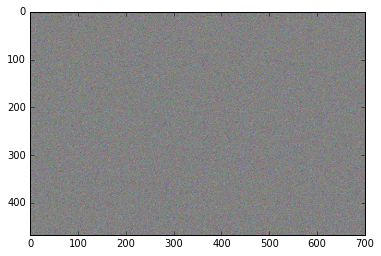

Epoch :  1
9.74606e+09
Epoch :  2
6.54078e+09
Epoch :  3
4.29943e+09
Epoch :  4
4.03191e+09
Epoch :  5
4.50615e+09
Epoch :  6
3.81519e+09
Epoch :  7
2.52592e+09
Epoch :  8
2.21879e+09
Epoch :  9
2.09132e+09
Epoch :  10
2.0115e+09
Epoch :  11
2.03295e+09
Epoch :  12
2.01607e+09
Epoch :  13
2.04837e+09
Epoch :  14
2.04519e+09
Epoch :  15
2.08399e+09
Epoch :  16
2.0933e+09
Epoch :  17
2.13735e+09
Epoch :  18
2.15637e+09
Epoch :  19
2.20572e+09
Epoch :  20
2.23259e+09


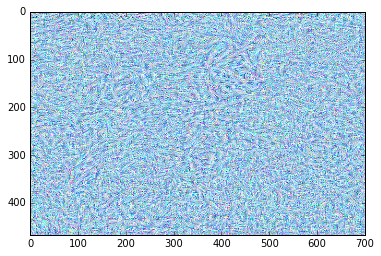

Epoch :  21
2.28871e+09
Epoch :  22
2.32629e+09
Epoch :  23
2.38588e+09
Epoch :  24
2.43683e+09
Epoch :  25
2.48836e+09
Epoch :  26
2.54664e+09
Epoch :  27
2.56994e+09
Epoch :  28
2.61733e+09
Epoch :  29
2.62102e+09
Epoch :  30
2.64987e+09
Epoch :  31
2.6578e+09
Epoch :  32
2.6864e+09
Epoch :  33
2.70897e+09
Epoch :  34
2.75654e+09
Epoch :  35
2.7864e+09
Epoch :  36
2.8653e+09
Epoch :  37
2.88201e+09
Epoch :  38
2.97993e+09
Epoch :  39
2.95346e+09
Epoch :  40
3.02639e+09


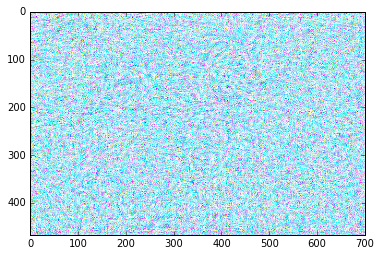

Epoch :  41
2.97478e+09
Epoch :  42
3.02008e+09
Epoch :  43
2.99912e+09
Epoch :  44
3.08537e+09
Epoch :  45
3.13488e+09
Epoch :  46
3.41126e+09
Epoch :  47
3.52842e+09
Epoch :  48
3.96257e+09
Epoch :  49
3.95521e+09
Epoch :  50
3.93771e+09
Epoch :  51
4.29502e+09
Epoch :  52
4.23311e+09
Epoch :  53
5.20439e+09
Epoch :  54
4.40749e+09
Epoch :  55
4.5338e+09
Epoch :  56
3.97132e+09
Epoch :  57
3.9679e+09
Epoch :  58
3.97206e+09
Epoch :  59
3.89887e+09
Epoch :  60
3.74417e+09


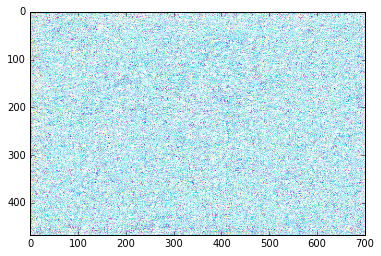

Epoch :  61
3.55404e+09
Epoch :  62
3.50253e+09
Epoch :  63
3.55076e+09
Epoch :  64
3.8416e+09
Epoch :  65
4.0825e+09
Epoch :  66
5.16571e+09
Epoch :  67
4.31476e+09
Epoch :  68
4.24113e+09
Epoch :  69
3.96773e+09
Epoch :  70
4.12429e+09
Epoch :  71
4.61148e+09
Epoch :  72
5.15007e+09
Epoch :  73
5.55981e+09
Epoch :  74
4.93635e+09
Epoch :  75
4.68619e+09
Epoch :  76
4.47395e+09
Epoch :  77
4.81623e+09
Epoch :  78
5.15878e+09
Epoch :  79
6.31475e+09
Epoch :  80
5.79983e+09


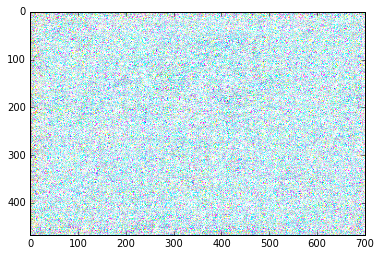

Epoch :  81
6.13997e+09
Epoch :  82
5.90849e+09
Epoch :  83
5.92312e+09
Epoch :  84
5.10074e+09
Epoch :  85
4.57885e+09
Epoch :  86
4.39903e+09
Epoch :  87
4.41147e+09
Epoch :  88
4.76093e+09
Epoch :  89
5.74112e+09
Epoch :  90
5.76483e+09
Epoch :  91
5.70701e+09
Epoch :  92
4.73278e+09
Epoch :  93
4.87174e+09
Epoch :  94
5.23109e+09
Epoch :  95
6.50385e+09
Epoch :  96
5.67813e+09
Epoch :  97
5.12865e+09
Epoch :  98
4.69719e+09
Epoch :  99
4.5212e+09


In [61]:
for it in range(num_epoch):
    print("Epoch : " , it)
    
    grads_values, loss_values = iterate([img_data])
    print(loss_values)
    
    losses.append(loss_values)
    
    
    ys_1 = img_data - (1. / smooth_number) * grads_values
    ys.append(ys_1)
    current_ys = ys[it]
    
    
    img_data = (1 - gammas[it + 1]) * ys_1 + gammas[it] * ys[it]
    
    if it % 20 == 0:
        img_toshow = build_img(np.copy(img_data),height=height,width=width)
        plt.figure()
        plt.imshow(img_toshow)
        plt.show()

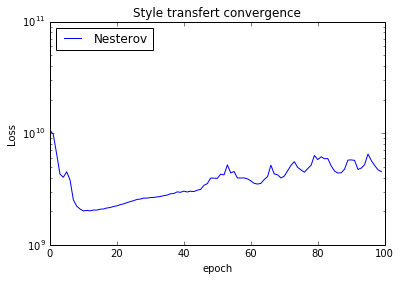

In [62]:
plt.figure()
ax = plt.gca()
ax.set_yscale('log')
plt.plot(losses)

plt.title('Style transfert convergence')
plt.ylabel('Loss')
plt.xlabel('epoch')
plt.legend(['Nesterov'], loc='upper left')

In [17]:
#Fonctions de gradient pour L-BFGS
def evaluate_loss_grads_from_flatten(flatten_input):   
    correct_input = flatten_input.reshape((1, height, width, 3))
    loss, grads= evaluate_loss_grads([correct_input])
    return loss, grads.flatten().astype('float64')


def getLoss(state):
    def getLoss_input(flatten_input):
        loss_values, grads_values = evaluate_loss_grads_from_flatten(flatten_input)
        state["loss"] = loss_values
        state["gradients"] = grads_values.flatten()
        #print("New state : ",state)
        return loss_values
    return getLoss_input

def getGrads(state):
    def getGrads_input(flatten_input):

        grads = state["gradients"]
        return grads.copy()
    
    return getGrads_input


it :  0
{'warnflag': 1, 'nit': 0, 'grad': array([ 103.80567932,   29.82748413,   67.9614563 , ...,  -86.56460571,
        -66.01970673,  -99.41329193]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


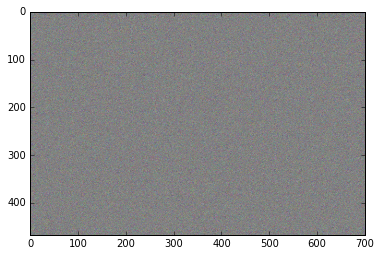

it :  1
{'warnflag': 1, 'nit': 0, 'grad': array([  84.59257507,  116.25312805,  128.18560791, ...,  -86.24150085,
        -56.77293396, -103.22772217]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


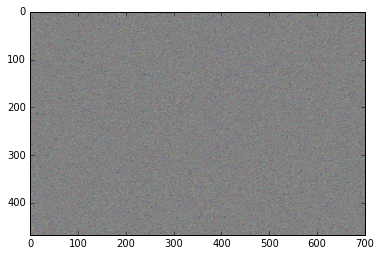

it :  2
{'warnflag': 1, 'nit': 0, 'grad': array([ 143.76818848,  194.79129028,  234.35638428, ...,  -85.40406799,
        -53.29715729, -102.38696289]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


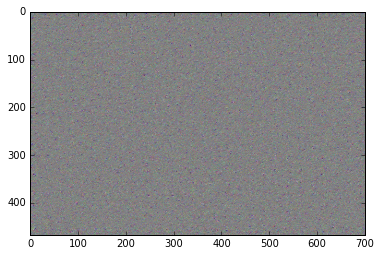

it :  3
{'warnflag': 1, 'nit': 0, 'grad': array([  3.13852692, -27.96914673,  34.63503265, ..., -79.97135162,
       -50.41492081, -88.64615631]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


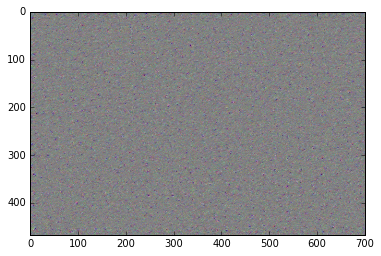

it :  4
{'warnflag': 1, 'nit': 0, 'grad': array([-33.31158447, -72.02680969,   2.05197906, ..., -64.59139252,
       -33.314888  , -76.01867676]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


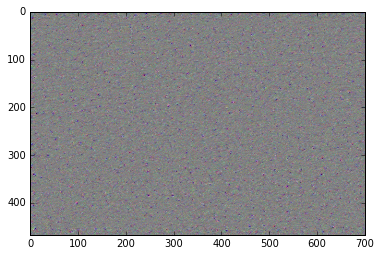

it :  5
{'warnflag': 1, 'nit': 0, 'grad': array([-20.09534073, -91.08050537,   7.19062424, ..., -47.16318512,
       -23.45527458, -54.046772  ]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


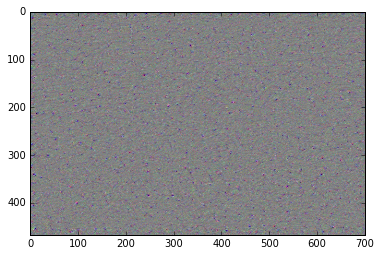

it :  6
{'warnflag': 1, 'nit': 1, 'grad': array([-12.05181122, -88.73647308,  19.78898811, ..., -33.72405243,
       -14.91848087, -40.76519775]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


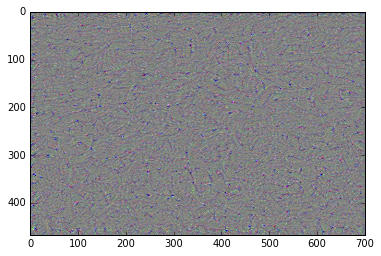

it :  7
{'warnflag': 1, 'nit': 2, 'grad': array([ -44.87345123, -120.80216217,   30.61648178, ...,  -15.13449574,
        -11.57903767,  -17.13721085]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


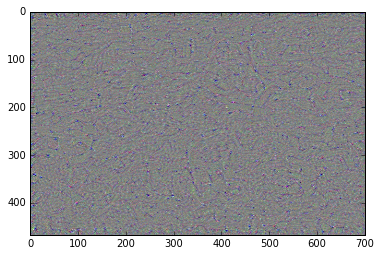

it :  8
{'warnflag': 1, 'nit': 2, 'grad': array([-40.06913757, -57.15531921, -21.29084778, ...,  -7.78402424,
        -2.721313  , -11.15428638]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


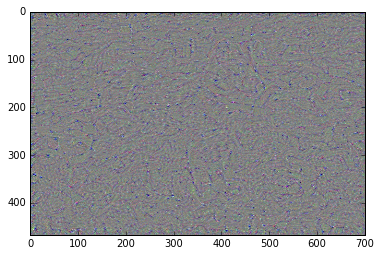

it :  9
{'warnflag': 1, 'nit': 2, 'grad': array([ -2.60294437, -17.18875885,  34.37969971, ..., -16.5357914 ,
        -9.09386444, -20.82185745]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


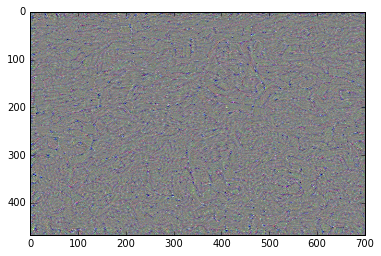

it :  10
{'warnflag': 1, 'nit': 2, 'grad': array([-18.20832825, -14.74659538,  17.2556076 , ...,  -9.94214821,
        -4.63724327, -12.51439381]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


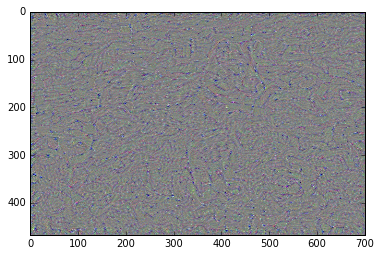

it :  11
{'warnflag': 1, 'nit': 2, 'grad': array([  5.47421455,  -2.11947346,  45.5647049 , ..., -12.26188469,
        -6.11554909, -15.37344265]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


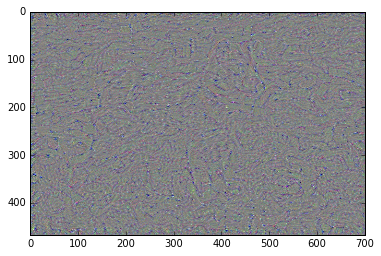

it :  12
{'warnflag': 1, 'nit': 2, 'grad': array([ -5.02697182,  20.3265686 ,  25.56436157, ...,  -8.46613979,
        -3.31608677, -11.02446175]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


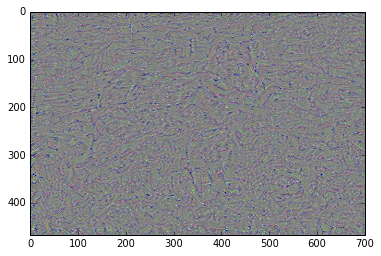

it :  13
{'warnflag': 1, 'nit': 3, 'grad': array([ 22.87287521,  23.19295883,  55.51751709, ..., -10.83435631,
        -4.59603453, -15.40434265]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


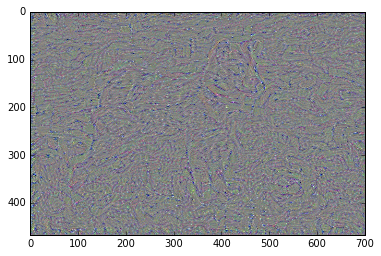

it :  14
{'warnflag': 1, 'nit': 2, 'grad': array([  7.63344193,  56.15696716,  32.49251175, ...,  -3.96648645,
        -1.51238632,  -6.03795815]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


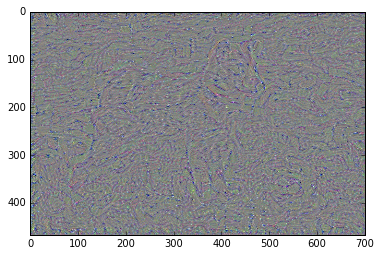

it :  15
{'warnflag': 1, 'nit': 3, 'grad': array([ 12.09264565,   9.78244972,  49.37922287, ...,  -7.75043583,
        -3.51395416, -10.90953636]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


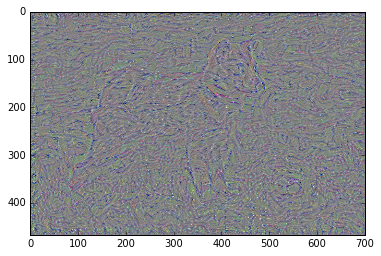

it :  16
{'warnflag': 1, 'nit': 3, 'grad': array([ -3.34161305,  18.15056229,  -4.28670311, ...,  -1.4902364 ,
         1.1954031 ,  -3.37956715]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


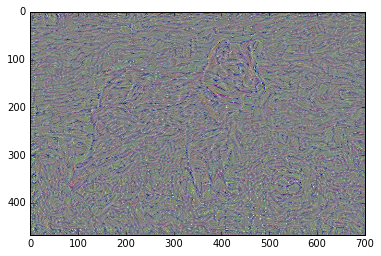

it :  17
{'warnflag': 1, 'nit': 3, 'grad': array([-2.75445104,  6.85175562, -8.93251705, ..., -0.38560665,
        1.63484502, -2.43907261]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


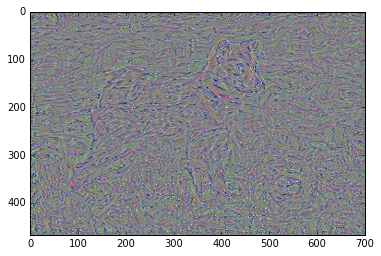

it :  18
{'warnflag': 1, 'nit': 3, 'grad': array([ -0.54903013,  27.26384163,  -0.92027688, ...,  -2.02294374,
        -1.1892072 ,  -2.42946053]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


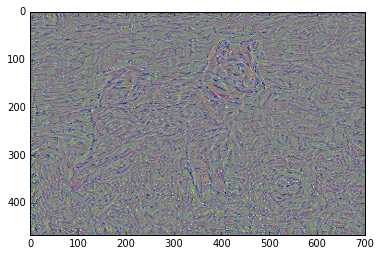

it :  19
{'warnflag': 1, 'nit': 3, 'grad': array([  6.63190794,  17.11106682,  13.80874443, ...,  -1.60547459,
        -0.84879541,  -2.22544718]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


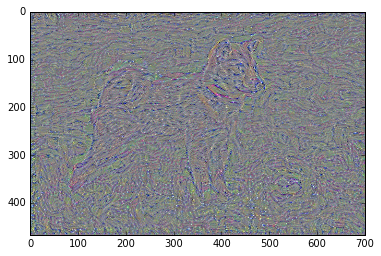

it :  20
{'warnflag': 1, 'nit': 2, 'grad': array([ 2.72386336,  7.27702141,  1.59255266, ..., -1.67631125,
       -0.85322422, -2.13630414]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


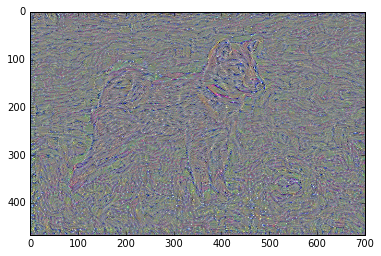

it :  21
{'warnflag': 1, 'nit': 3, 'grad': array([ 7.79098606,  8.9106884 ,  8.30461884, ..., -1.73144376,
       -1.27252805, -2.150002  ]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


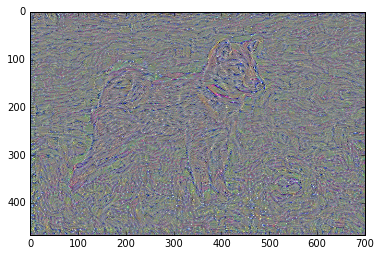

it :  22
{'warnflag': 1, 'nit': 3, 'grad': array([-0.57073998,  7.21967125, -9.34161091, ..., -0.04965377,
       -0.32280162, -0.31058118]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


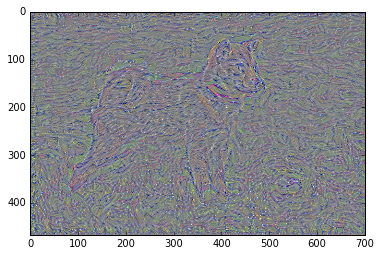

it :  23
{'warnflag': 1, 'nit': 3, 'grad': array([ 11.82309341,  15.28917789,   6.87718678, ...,  -0.80864346,
        -0.85408086,  -1.19456899]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


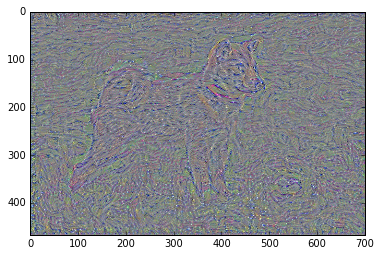

it :  24
{'warnflag': 1, 'nit': 3, 'grad': array([ 1.33912265,  5.61543703, -4.00817013, ..., -0.90658998,
       -0.67933035, -1.47779119]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


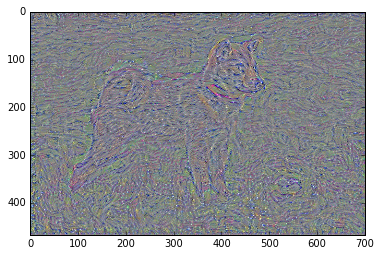

it :  25
{'warnflag': 1, 'nit': 2, 'grad': array([  3.86441612,   7.51201534, -10.94202042, ...,   0.34264514,
        -0.41273704,   0.34267503]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


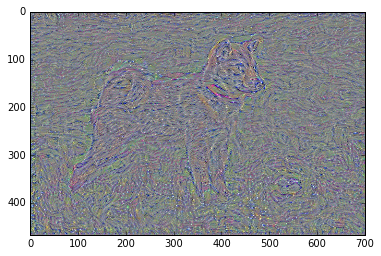

it :  26
{'warnflag': 1, 'nit': 3, 'grad': array([  0.3946602 ,   4.31880379, -10.65767479, ...,   0.26668188,
        -0.3504647 ,  -0.05176357]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


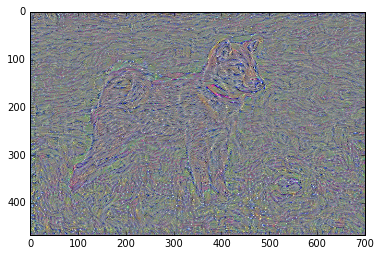

it :  27
{'warnflag': 1, 'nit': 3, 'grad': array([ 7.54171944,  7.58262062,  1.05788231, ..., -1.13969254,
       -1.41609967, -1.52811599]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


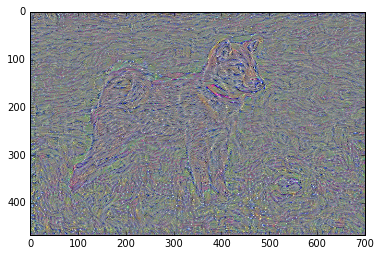

it :  28
{'warnflag': 1, 'nit': 3, 'grad': array([ 2.00810838,  2.89503384, -6.81614304, ..., -0.04323405,
       -0.66456473, -0.48256636]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


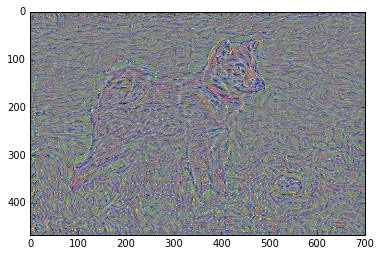

it :  29
{'warnflag': 1, 'nit': 3, 'grad': array([ 7.98319626,  8.81737709, -1.14539611, ..., -0.55451351,
       -0.86485237, -0.70783353]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


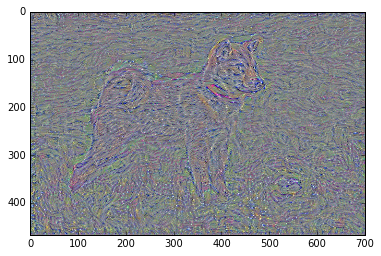

it :  30
{'warnflag': 1, 'nit': 3, 'grad': array([ 5.59037924,  5.12772703,  1.49087107, ..., -1.44687104,
       -1.44470251, -1.89840651]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


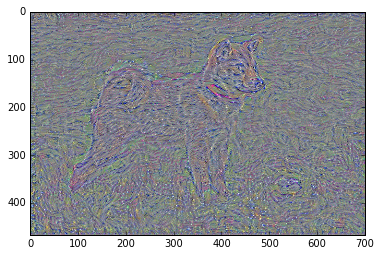

it :  31
{'warnflag': 1, 'nit': 3, 'grad': array([ 6.16584206,  6.46908951, -6.12591362, ...,  0.23110557,
       -0.35769245, -0.09892381]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


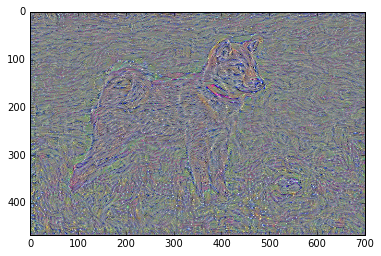

it :  32
{'warnflag': 1, 'nit': 3, 'grad': array([ 6.8432126 ,  6.59071398, -1.46196973, ..., -0.87313187,
       -0.90866452, -1.05776584]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


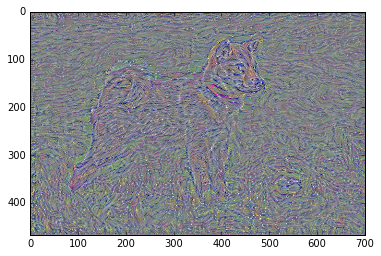

it :  33
{'warnflag': 1, 'nit': 3, 'grad': array([ 8.72841263,  8.94943619, -6.00965452, ...,  0.12209848,
       -0.47497898, -0.06175458]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


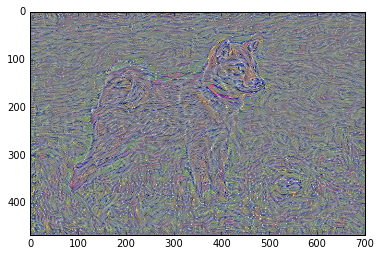

it :  34
{'warnflag': 1, 'nit': 3, 'grad': array([ 6.73676872,  4.98946714, -2.20718694, ..., -0.72660154,
       -0.89082998, -0.89839613]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


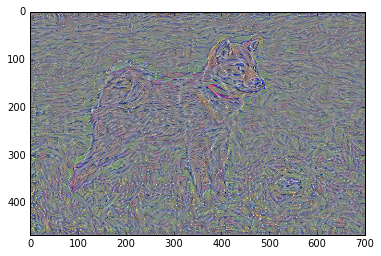

it :  35
{'warnflag': 1, 'nit': 3, 'grad': array([ 6.91297531,  6.25304031, -5.08861971, ..., -0.16324177,
       -0.40255195, -0.22232963]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


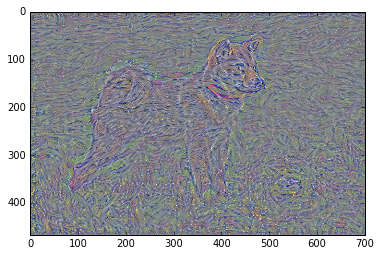

it :  36
{'warnflag': 1, 'nit': 3, 'grad': array([ 6.11375618,  4.46688986, -3.884027  , ..., -0.64421576,
       -0.61651272, -0.98554796]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


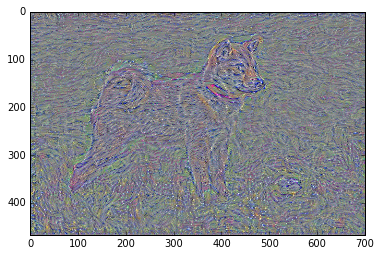

it :  37
{'warnflag': 1, 'nit': 3, 'grad': array([ 4.60465336, -0.72521806, -4.98654556, ..., -0.03573553,
       -0.30855706, -0.28059581]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


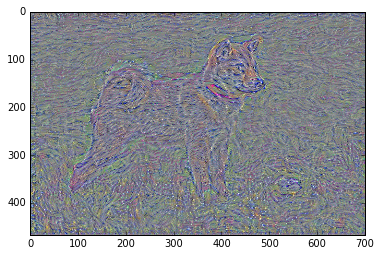

it :  38
{'warnflag': 1, 'nit': 3, 'grad': array([ 5.59703255,  3.13797474, -4.78119659, ..., -0.66516542,
       -0.47094491, -0.71380299]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


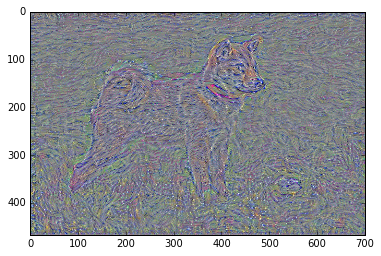

it :  39
{'warnflag': 1, 'nit': 3, 'grad': array([  3.82152557e+00,   4.75385070e-01,  -6.67117405e+00, ...,
        -6.07651286e-03,  -1.33768082e-01,  -1.35726854e-01]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


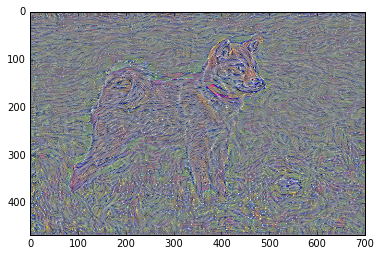

it :  40
{'warnflag': 1, 'nit': 3, 'grad': array([ 5.17720222,  2.72432947, -4.50634098, ..., -0.83066952,
       -0.53374195, -1.00860667]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


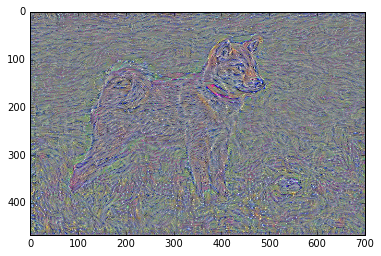

it :  41
{'warnflag': 1, 'nit': 4, 'grad': array([ 4.14173889,  0.25201452, -6.5426302 , ...,  0.09431365,
        0.17034267,  0.2664144 ]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


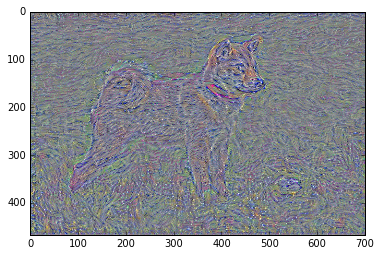

it :  42
{'warnflag': 1, 'nit': 3, 'grad': array([ 7.35162258,  4.23023844, -2.42275953, ..., -0.59584755,
       -0.31893003, -0.57835865]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


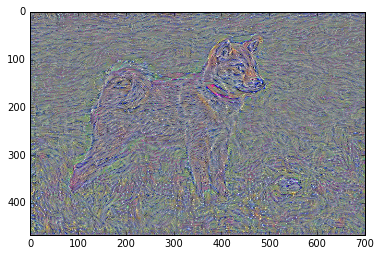

it :  43
{'warnflag': 1, 'nit': 3, 'grad': array([ 6.07653332,  0.8403632 , -5.44651222, ..., -0.15528302,
       -0.19904935, -0.11276275]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


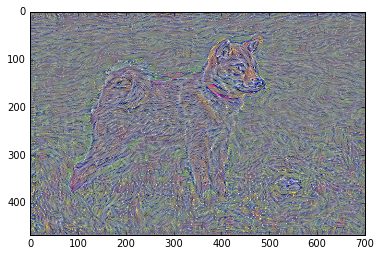

it :  44
{'warnflag': 1, 'nit': 3, 'grad': array([ 5.87501144,  2.5376482 , -3.15585375, ..., -0.67603827,
       -0.36501765, -0.66454291]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


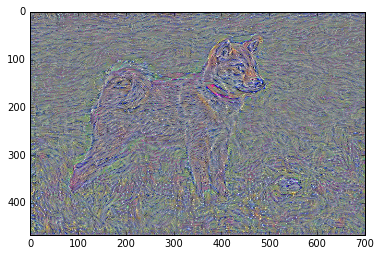

it :  45
{'warnflag': 1, 'nit': 4, 'grad': array([ 4.55210543,  0.89910364, -4.50016403, ...,  0.01939203,
        0.16794591,  0.18347102]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


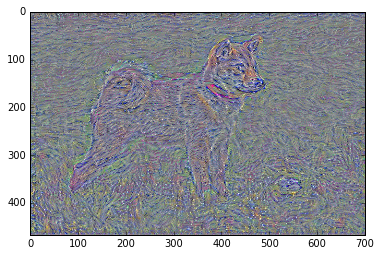

it :  46
{'warnflag': 1, 'nit': 2, 'grad': array([ 5.12196636,  1.36519551, -1.45791423, ...,  0.47646111,
        0.11038525,  0.59789556]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


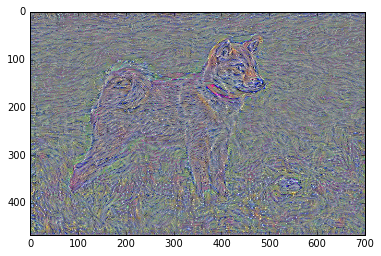

it :  47
{'warnflag': 1, 'nit': 4, 'grad': array([  4.68601131e+00,   8.32622528e-01,  -3.95901442e+00, ...,
        -8.05714667e-01,  -1.59738923e-03,  -5.40866733e-01]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


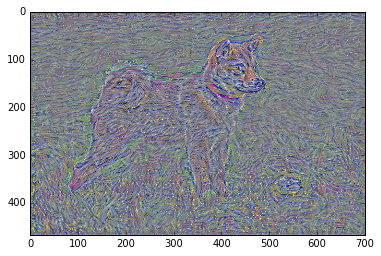

it :  48
{'warnflag': 1, 'nit': 3, 'grad': array([ 4.26624203,  0.86764228, -1.63747001, ..., -0.21569219,
        0.0360096 , -0.11425672]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


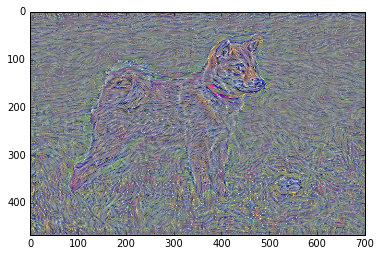

it :  49
{'warnflag': 1, 'nit': 3, 'grad': array([ 3.25077128,  0.36367449, -2.50476313, ..., -0.46478224,
        0.16824475, -0.24759541]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


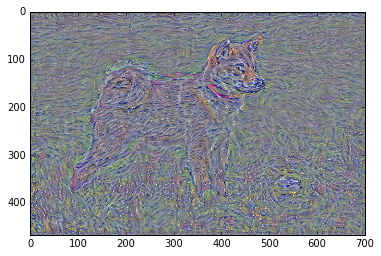

it :  50
{'warnflag': 1, 'nit': 3, 'grad': array([ 4.3592453 ,  0.20432162,  0.72657907, ...,  0.19253409,
        0.05462951,  0.26721793]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


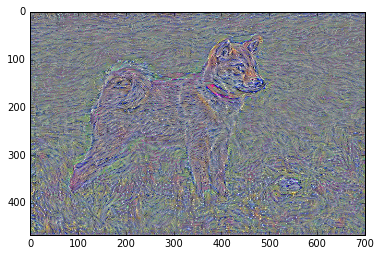

it :  51
{'warnflag': 1, 'nit': 4, 'grad': array([ 1.59492254, -2.99082327, -2.93316197, ..., -0.83354628,
       -0.0049829 , -0.59219491]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


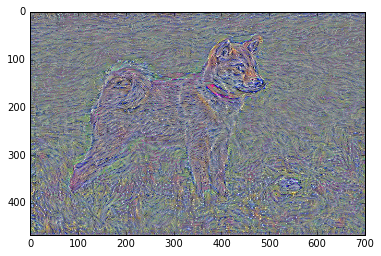

it :  52
{'warnflag': 1, 'nit': 3, 'grad': array([ 4.93208313,  2.06471682,  1.05872285, ..., -0.0577953 ,
        0.21599521,  0.11254421]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


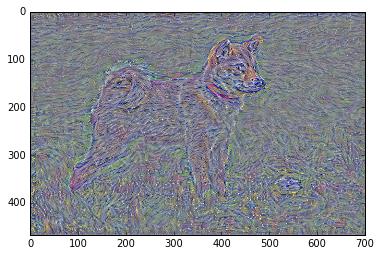

it :  53
{'warnflag': 1, 'nit': 4, 'grad': array([ 4.82834005,  3.26657391,  0.24527916, ..., -0.44132128,
        0.36707103, -0.12583633]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


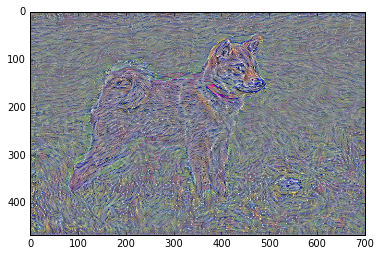

it :  54
{'warnflag': 1, 'nit': 3, 'grad': array([ 4.22349405,  3.87907934,  0.70977139, ..., -0.26121992,
        0.18141843, -0.09894003]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


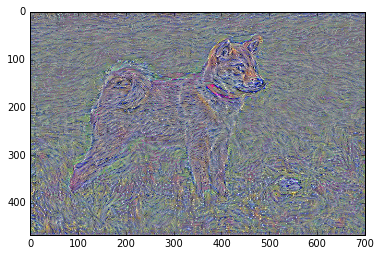

it :  55
{'warnflag': 1, 'nit': 3, 'grad': array([ 3.96811724,  5.49290133,  1.7691642 , ...,  0.31557998,
        0.53249502,  0.49769819]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


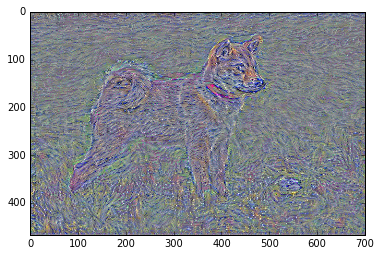

it :  56
{'warnflag': 1, 'nit': 3, 'grad': array([ 4.45711327,  2.69700384,  0.34824336, ..., -0.90774798,
        0.22357036, -0.54935384]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


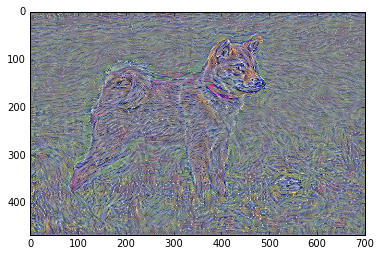

it :  57
{'warnflag': 1, 'nit': 4, 'grad': array([ 2.42884278,  3.50164819,  1.55385494, ...,  0.82656455,
        0.67913634,  1.00470078]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


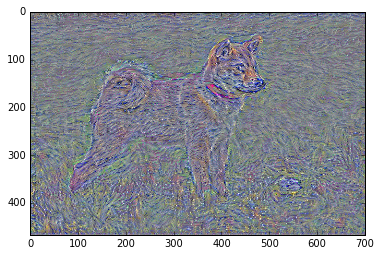

it :  58
{'warnflag': 1, 'nit': 4, 'grad': array([ 2.82796645,  1.25364375,  0.34007102, ..., -0.31484762,
        0.23220599, -0.05062389]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


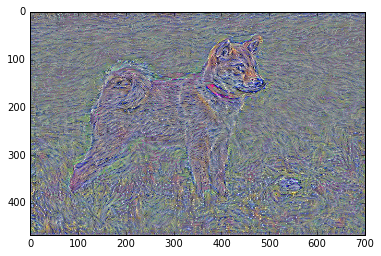

it :  59
{'warnflag': 1, 'nit': 4, 'grad': array([ 1.31333828,  3.93638515,  1.10186529, ...,  0.34514719,
        0.62980062,  0.63019145]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


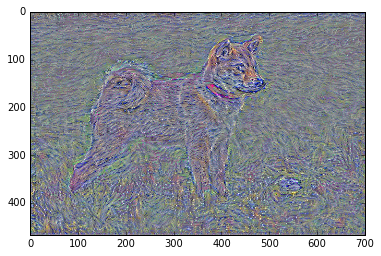

it :  60
{'warnflag': 1, 'nit': 3, 'grad': array([ 1.67933404,  2.75489664,  0.17828679, ...,  0.4339478 ,
        0.5171209 ,  0.6201781 ]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


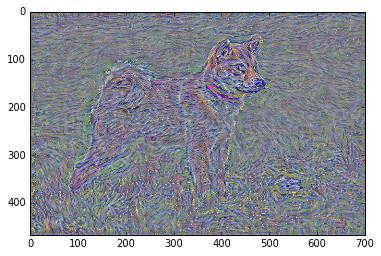

it :  61
{'warnflag': 1, 'nit': 4, 'grad': array([ 2.44762325,  3.23124671, -0.03718036, ..., -0.517775  ,
        0.42418408, -0.07765226]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


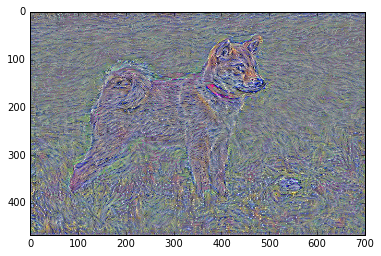

it :  62
{'warnflag': 1, 'nit': 4, 'grad': array([ 2.14633226,  3.33903027, -0.69735384, ..., -0.10866578,
        0.33672807,  0.16759335]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


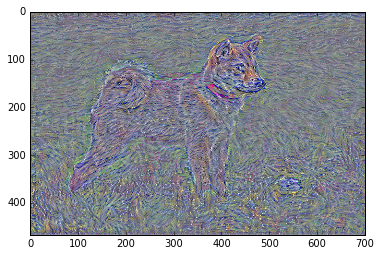

it :  63
{'warnflag': 1, 'nit': 3, 'grad': array([ 1.1204772 ,  4.38268709,  0.35662448, ...,  0.55286813,
        0.73894906,  0.79558909]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


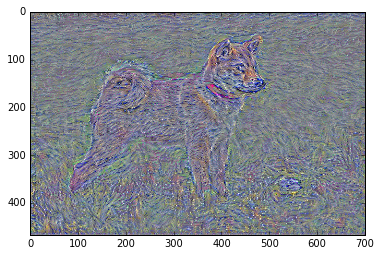

it :  64
{'warnflag': 1, 'nit': 4, 'grad': array([ 1.98924887,  1.78472853, -0.42259434, ..., -0.54258448,
        0.23141505, -0.168982  ]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


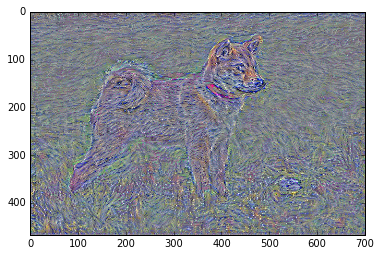

it :  65
{'warnflag': 1, 'nit': 4, 'grad': array([ 1.75642824,  3.39707875,  1.03211808, ...,  0.07393356,
        0.54912198,  0.39098591]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


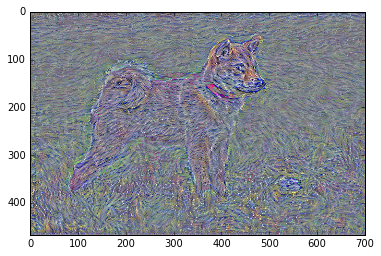

it :  66
{'warnflag': 1, 'nit': 3, 'grad': array([ 1.96950531,  3.39582014,  1.39352202, ...,  0.06955789,
        0.324626  ,  0.29479524]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


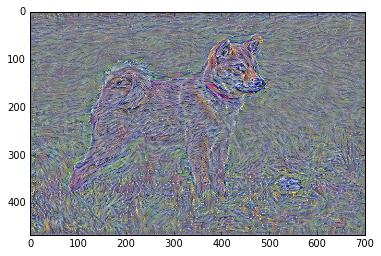

it :  67
{'warnflag': 1, 'nit': 4, 'grad': array([-0.97861886,  3.77111554,  0.46354353, ..., -0.51328564,
        0.32835969, -0.11034511]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


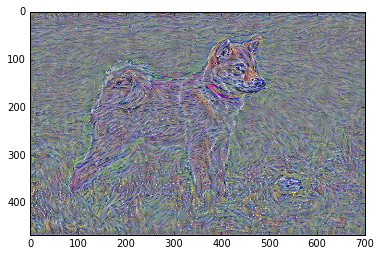

it :  68
{'warnflag': 1, 'nit': 4, 'grad': array([ 1.20051241,  3.42314148,  1.83320999, ...,  0.0429594 ,
        0.20099315,  0.30168468]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


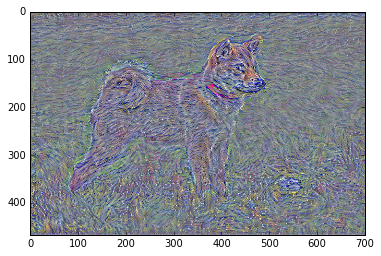

it :  69
{'warnflag': 1, 'nit': 4, 'grad': array([-1.22544241,  4.91166162,  0.30974257, ..., -0.1369101 ,
        0.55346286,  0.19025758]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


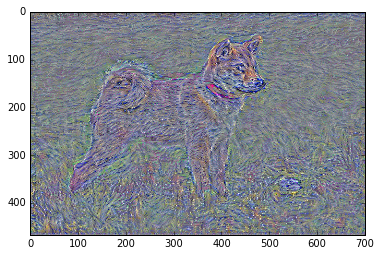

it :  70
{'warnflag': 1, 'nit': 4, 'grad': array([-0.22571325,  3.17969656,  0.64219528, ...,  0.04221787,
        0.20123899,  0.26790613]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


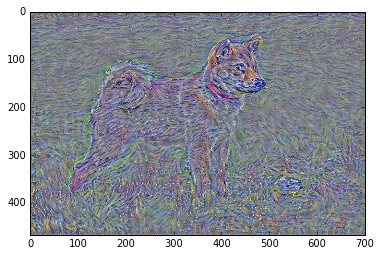

it :  71
{'warnflag': 1, 'nit': 4, 'grad': array([-0.49520844,  4.53083324,  0.01125559, ..., -0.11390466,
        0.53139096,  0.22065182]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


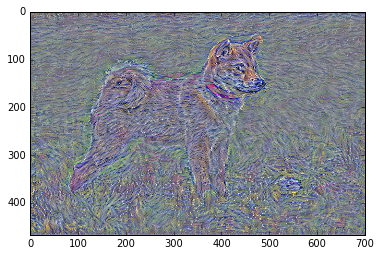

it :  72
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.8446728 ,  3.9066422 ,  1.64382505, ..., -0.0954075 ,
        0.24204233,  0.20259698]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


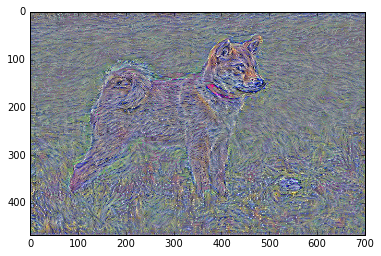

it :  73
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.50544006,  3.42525673, -1.51305485, ...,  0.03486356,
        0.46548668,  0.2685121 ]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


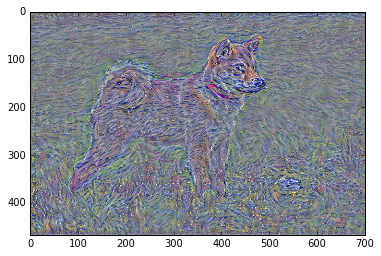

it :  74
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.57015717,  1.85050583,  0.82114029, ...,  0.13139468,
        0.23235315,  0.40143129]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


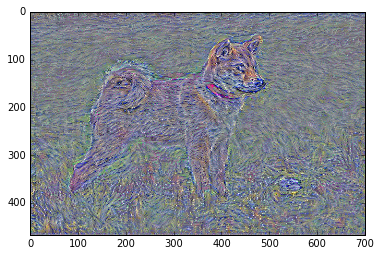

it :  75
{'warnflag': 1, 'nit': 3, 'grad': array([ 1.03702021,  3.05166793, -2.23638296, ..., -0.81701118,
        0.29566211, -0.30739397]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


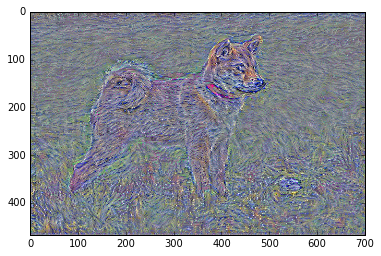

it :  76
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.74026054,  1.86644435,  1.48975706, ...,  0.2215004 ,
        0.21923062,  0.45597982]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


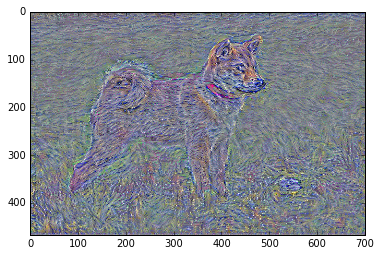

it :  77
{'warnflag': 1, 'nit': 4, 'grad': array([ 1.40939856,  2.65083385, -1.81669223, ..., -0.49779516,
        0.30794752, -0.13905308]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


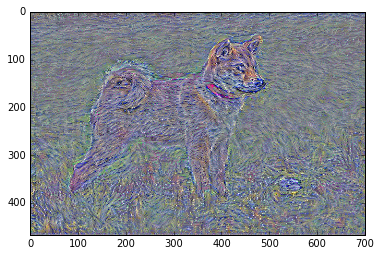

it :  78
{'warnflag': 1, 'nit': 4, 'grad': array([ 1.45632827,  2.02092552,  1.63715017, ..., -0.09669762,
        0.13324419,  0.19981454]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


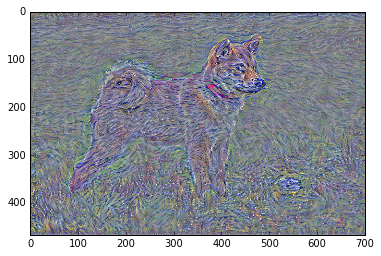

it :  79
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.22284645,  2.42340231, -1.49611259, ..., -0.75585914,
        0.21905869, -0.39744511]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


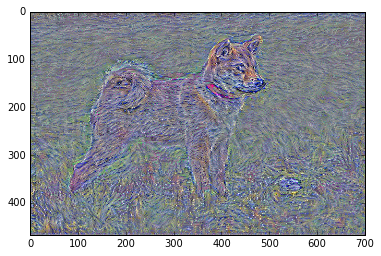

it :  80
{'warnflag': 1, 'nit': 3, 'grad': array([ 0.921161  ,  1.46436882,  1.94760931, ..., -0.52229196,
        0.08027309, -0.13649236]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


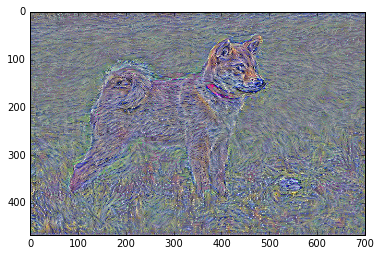

it :  81
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.3698729 ,  2.13980222, -0.80699956, ...,  0.0274798 ,
        0.25453135,  0.21429348]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


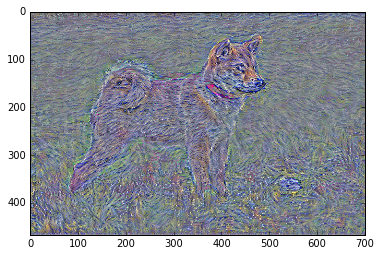

it :  82
{'warnflag': 1, 'nit': 4, 'grad': array([-0.15146419,  0.17519176,  2.39384055, ...,  0.34705117,
        0.15413059,  0.54083681]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


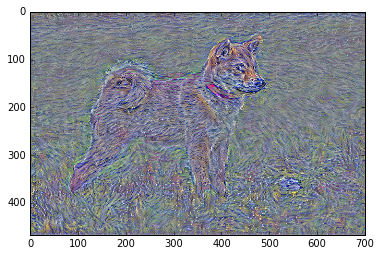

it :  83
{'warnflag': 1, 'nit': 4, 'grad': array([-1.15291929,  0.96790957, -2.04567099, ..., -0.21624736,
        0.1900807 ,  0.00838607]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


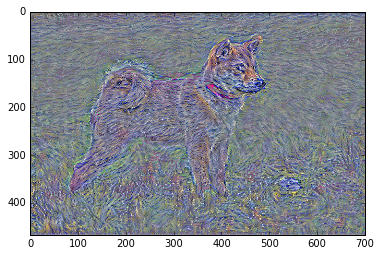

it :  84
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.62747258,  1.03984404,  2.89708424, ...,  0.25141826,
        0.20083117,  0.46988338]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


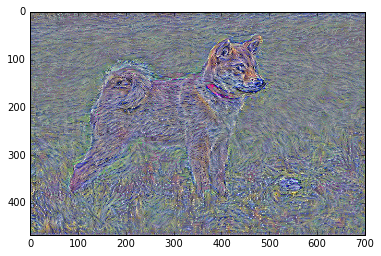

it :  85
{'warnflag': 1, 'nit': 4, 'grad': array([-0.53015119,  1.31958652, -1.67249942, ..., -0.19692785,
        0.11876641, -0.0279205 ]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


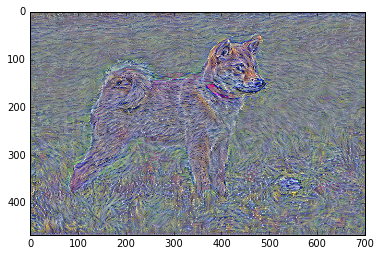

it :  86
{'warnflag': 1, 'nit': 4, 'grad': array([ 1.51338196,  1.71612287,  2.23247814, ...,  0.1152894 ,
        0.18367893,  0.32579562]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


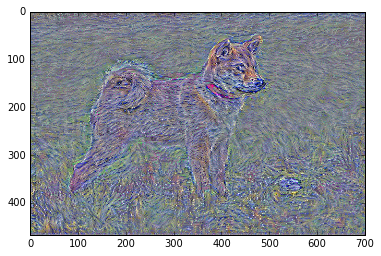

it :  87
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.14841825,  2.06536818, -0.78381491, ..., -0.30658934,
        0.13152444, -0.1058009 ]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


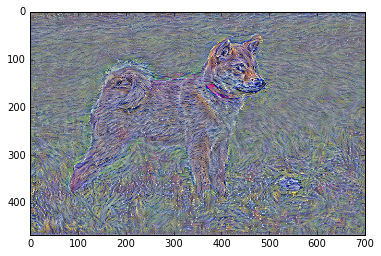

it :  88
{'warnflag': 1, 'nit': 4, 'grad': array([-0.05257511,  0.89295989,  0.82843304, ..., -0.0748428 ,
        0.08621562,  0.14608607]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


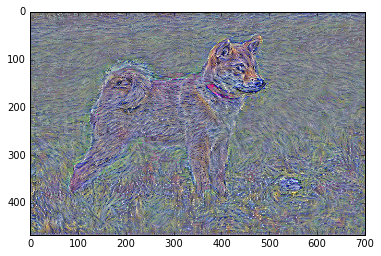

it :  89
{'warnflag': 1, 'nit': 4, 'grad': array([-0.00391459,  2.19537163, -0.27366388, ...,  0.12783146,
        0.32334584,  0.18776049]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


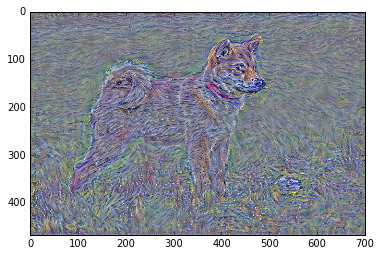

it :  90
{'warnflag': 1, 'nit': 3, 'grad': array([ 0.17295602,  1.10344541,  1.7724272 , ...,  0.40511459,
        0.24250127,  0.51684409]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


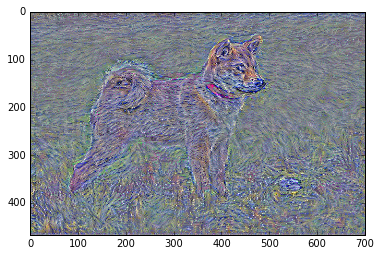

it :  91
{'warnflag': 1, 'nit': 4, 'grad': array([-0.41197738,  2.20370936, -0.56956333, ..., -0.41399568,
        0.08597495, -0.19772708]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


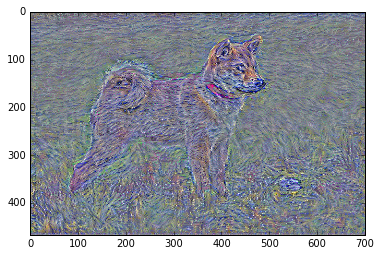

it :  92
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.6738317 ,  1.88797116,  1.9924072 , ...,  0.24282664,
        0.18716569,  0.38395903]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


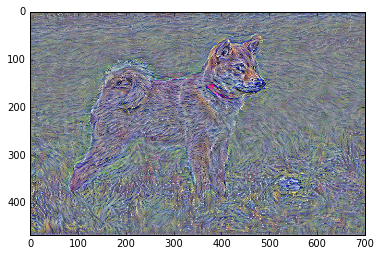

it :  93
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.4086417 ,  2.56514359,  0.30110863, ..., -0.13385364,
        0.25829065,  0.04521526]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


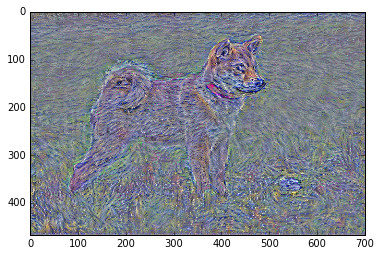

it :  94
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.13275778,  1.34223223,  1.23461556, ..., -0.00898491,
        0.0942371 ,  0.18656927]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


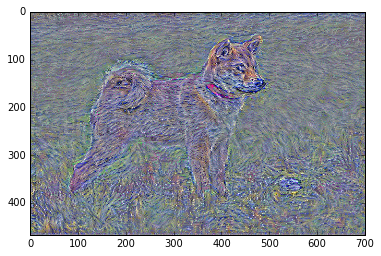

it :  95
{'warnflag': 1, 'nit': 4, 'grad': array([-0.2346136 ,  1.86338806, -0.58607674, ..., -0.24580413,
        0.18773741, -0.05164713]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


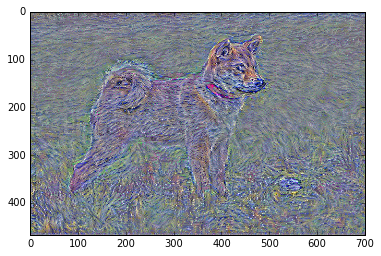

it :  96
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.86204612,  2.21509457,  1.49162269, ...,  0.23736775,
        0.19040951,  0.38080209]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


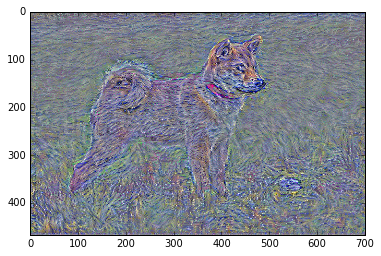

it :  97
{'warnflag': 1, 'nit': 4, 'grad': array([-0.50877297,  1.73847425, -0.45724422, ..., -0.15411669,
        0.15308763, -0.04857222]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


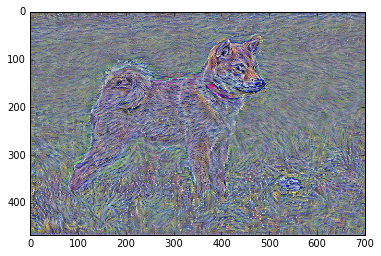

it :  98
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.68982059,  2.99395847,  1.48378515, ..., -0.04433312,
        0.10851968,  0.18914093]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


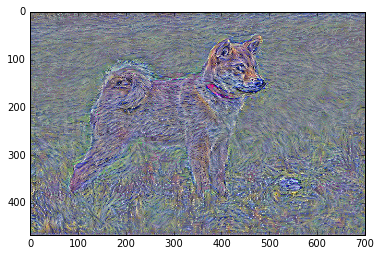

it :  99
{'warnflag': 1, 'nit': 4, 'grad': array([ 0.72833723,  1.86017489,  0.47923124, ...,  0.09852514,
        0.23137207,  0.13941762]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 6}
Final picture : 


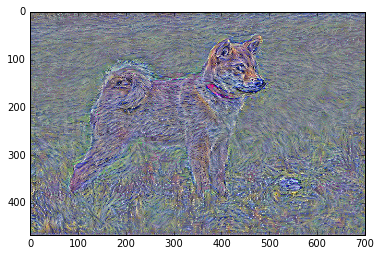

In [21]:
state = {}

img_data = np.random.uniform(110,150,((1, height, width,3)))
img_data = preprocess_input(img_data)


def display(xk):
    print("Current best image :")
    copy = xk.copy()
    copy = copy.reshape((1, height, width, 3))
    img_toshow = build_img(copy,height=height,width=width)
    plt.figure()
    plt.imshow(copy)
    plt.show()

loss_lbfgs = []

for it in range(100):
    min_input, min_val, info = fmin_l_bfgs_b(getLoss(state), img_data.flatten(),fprime=getGrads(state), maxiter=3, maxfun=5)
    
    loss_lbfgs.append(min_val)
    print("it : ", it)
    print(info)
    print("Final picture : ")
    img_data = min_input.reshape((1, height, width, 3))
    best_img = img_data.copy()
    best_img = best_img.reshape((1, height, width, 3))
    img_toshow = build_img(best_img,height=height,width=width)
    plt.figure()
    plt.imshow(img_toshow)
    plt.show()

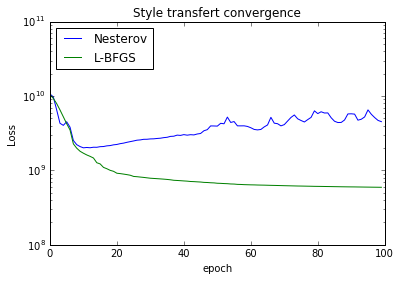

In [63]:
plt.figure()
ax = plt.gca()
ax.set_yscale('log')
plt.plot(losses)
plt.plot(loss_lbfgs)

plt.title('Style transfert convergence')
plt.ylabel('Loss')
plt.xlabel('epoch')
plt.legend(['Nesterov', 'L-BFGS'], loc='upper left')

In [24]:
imsave("chien_van_gogh.jpg",img_toshow)